In [1]:
import os

from math import log2
import tensorflow as tf
import tensorflow.keras.layers as L
from tensorflow.keras.models import Model
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        os.path.join(dirname, filename)

In [2]:
import tensorflow as tf
from tensorflow.keras import layers as L

def channel_attention(input_tensor, reduction_ratio=16):
    # Global Average Pooling
    channel_avg = L.GlobalAveragePooling2D()(input_tensor)
    channel_avg = L.Dense(input_tensor.shape[-1] // reduction_ratio, activation='relu')(channel_avg)
    channel_avg = L.Dense(input_tensor.shape[-1], activation='sigmoid')(channel_avg)

    # Reshape to original tensor shape
    channel_avg = L.Reshape((1, 1, input_tensor.shape[-1]))(channel_avg)
    return input_tensor * channel_avg


def mlp(x, cf):
    x = L.Dense(cf["mlp_dim"], activation="gelu")(x)
    x = L.Dropout(cf["dropout_rate"])(x)
    x = L.Dense(cf["hidden_dim"])(x)
    x = L.Dropout(cf["dropout_rate"])(x)
    return x
def transformer_encoder(x, cf):
    skip_1 = x
    x = L.LayerNormalization()(x)
    x = L.GroupQueryAttention(head_dim=cf["head_dim"], 
    num_query_heads=cf["num_query_heads"],
    num_key_value_heads=cf["num_key_value_heads"])( x, x)
    x = L.Add()([x, skip_1])

    skip_2 = x
    x = L.LayerNormalization()(x)
    x = mlp(x, cf)
    x = L.Add()([x, skip_2])

    return x

def conv_block(x, num_filters):
    x = L.Conv2D(num_filters,  [3, 3], padding="same")(x)
    x = L.BatchNormalization()(x)
    x = L.ReLU()(x)
    return x

def deconv_block(x, num_filters, strides=2):
    x = L.Conv2DTranspose(num_filters, kernel_size=2, padding="same", strides=strides)(x)
    return x

def build_unetr_2d(cf):
    """ Inputs """
    input_shape = (cf["num_patches"], cf["patch_size"]*cf["patch_size"]*cf["num_channels"])
    inputs = L.Input(input_shape) ## (None, 256, 3072)

    """ Patch + Position Embeddings """
    patch_embed = L.Dense(cf["hidden_dim"])(inputs) ## (None, 256, 768)

    positions = tf.range(start=0, limit=cf["num_patches"], delta=1) ## (256,)
    pos_embed = L.Embedding(input_dim=cf["num_patches"], output_dim=cf["hidden_dim"])(positions) ## (256, 768)
    x = patch_embed + pos_embed ## (None, 256, 768)

    """ Transformer Encoder """
    skip_connection_index = [3, 6, 9, 12]
    skip_connections = []

    for i in range(1, cf["num_layers"]+1, 1):
        x = transformer_encoder(x, cf)

        if i in skip_connection_index:
            skip_connections.append(x)

    """ CNN Decoder """
    z3, z6, z9, z12 = skip_connections

    ## Reshaping
    z0 = L.Reshape((cf["image_size"], cf["image_size"], cf["num_channels"]))(inputs)

    shape = (
        cf["image_size"]//cf["patch_size"],
        cf["image_size"]//cf["patch_size"],
        cf["hidden_dim"]
    )
    z3 = L.Reshape(shape)(z3)
    z6 = L.Reshape(shape)(z6)
    z9 = L.Reshape(shape)(z9)
    z12 = L.Reshape(shape)(z12)

    ## Additional layers for managing different patch sizes
    total_upscale_factor = int(log2(cf["patch_size"]))
    upscale = total_upscale_factor - 4

    if upscale >= 2: ## Patch size 16 or greater
        z3 = deconv_block(z3, z3.shape[-1], strides=2**upscale)
        z6 = deconv_block(z6, z6.shape[-1], strides=2**upscale)
        z9 = deconv_block(z9, z9.shape[-1], strides=2**upscale)
        z12 = deconv_block(z12, z12.shape[-1], strides=2**upscale)
        # print(z3.shape, z6.shape, z9.shape, z12.shape)

    if upscale < 0: ## Patch size less than 16
        p = 2**abs(upscale)
        z3 = L.MaxPool2D((p, p))(z3)
        z6 = L.MaxPool2D((p, p))(z6)
        z9 = L.MaxPool2D((p, p))(z9)
        z12 = L.MaxPool2D((p, p))(z12)

    ## Decoder 1
    x = deconv_block(z12, 128)

    s = deconv_block(z9, 128)
    s = conv_block(s, 128)

    x = L.Concatenate()([x, s])
    x = channel_attention(x)
    x = conv_block(x, 128)
    x = conv_block(x, 128)
    out1 = L.Conv2D(1, kernel_size=1, padding="same", activation="sigmoid")(x)
    ## Decoder 2
    x = deconv_block(x, 64)

    s = deconv_block(z6, 64)
    s = conv_block(s, 64)
    s = deconv_block(s, 64)
    s = conv_block(s, 64)

    x = L.Concatenate()([x, s])
    x = channel_attention(x)
    x = conv_block(x, 64)
    x = conv_block(x, 64)
    out2 = L.Conv2D(1, kernel_size=1, padding="same", activation="sigmoid")(x)
    ## Decoder 3
    x = deconv_block(x, 32)

    s = deconv_block(z3, 32)
    s = conv_block(s, 32)
    s = deconv_block(s, 32)
    s = conv_block(s, 32)
    s = deconv_block(s, 32)
    s = conv_block(s, 32)

    x = L.Concatenate()([x, s])
    x = channel_attention(x)
    x = conv_block(x, 32)
    x = conv_block(x, 32)
    out3 = L.Conv2D(1, kernel_size=1, padding="same", activation="sigmoid")(x)
    ## Decoder 4
    x = deconv_block(x, 16)

    s = conv_block(z0, 16)
    s = conv_block(s, 16)

    x = L.Concatenate()([x, s])
    x = channel_attention(x)
    x = conv_block(x, 16)
    x = conv_block(x, 16)
    final_output = L.Conv2D(1, kernel_size=1, padding="same", activation="sigmoid", name="final_output")(x)

    out1 = L.Resizing(256, 256, interpolation="bilinear", name="out1")(out1)
    out2 = L.Resizing(256, 256, interpolation="bilinear", name="out2")(out2)
    out3 = L.Resizing(256, 256, interpolation="bilinear", name="out3")(out3)

    return Model(inputs, [out1, out2, out3, final_output], name="UNETR_2D")

In [3]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
import tensorflow as tf
from datetime import datetime
import cv2
smooth = 1e-15
def dice_coef(y_true, y_pred):
    y_true = tf.keras.layers.Flatten()(y_true)
    y_pred = tf.keras.layers.Flatten()(y_pred)
    intersection = tf.reduce_sum(y_true * y_pred)
    return (2. * intersection + smooth) / (tf.reduce_sum(y_true) + tf.reduce_sum(y_pred) + smooth)
def iou(y_true, y_pred, smooth=1e-6):
    y_true = tf.keras.layers.Flatten()(y_true)
    y_pred = tf.keras.layers.Flatten()(y_pred)
    intersection = tf.reduce_sum(y_true * y_pred)
    y_true_sum = tf.reduce_sum(y_true)
    y_pred_sum = tf.reduce_sum(y_pred)
    union = y_true_sum + y_pred_sum - intersection
    iou = (intersection + smooth) / (union + smooth)
    return iou

def dice_loss(y_true, y_pred):
    return 1.0 - dice_coef(y_true, y_pred)

from keras.losses import binary_crossentropy, BinaryCrossentropy

def bce_dice_loss(y_true, y_pred):
        loss = binary_crossentropy(y_true, y_pred) + \
               dice_loss(y_true, y_pred)
        return loss / 2.0



In [4]:
pip install patchify

/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


Note: you may need to restart the kernel to use updated packages.


In [5]:
import cv2
import numpy as np

mask = cv2.imread("/kaggle/input/refuge2/REFUGE2/test/mask/T0001.bmp", cv2.IMREAD_GRAYSCALE)
print("Unique values in mask:", np.unique(mask))


Unique values in mask: [  0 128 255]


In [6]:
import cv2
from glob import glob
from sklearn.utils import shuffle
from tensorflow.keras.callbacks import ModelCheckpoint, CSVLogger, ReduceLROnPlateau, EarlyStopping
from tensorflow.keras.optimizers import Adam, SGD
from sklearn.model_selection import train_test_split
from patchify import patchify

""" UNETR  Configration """
cf = {}
cf["image_size"] = 256
cf["num_channels"] = 3
cf["num_layers"] = 12
cf["hidden_dim"] = 128
cf["mlp_dim"] = 32
cf["dropout_rate"] = 0.1
cf["patch_size"] = 16
cf["num_patches"] = (cf["image_size"]**2)//(cf["patch_size"]**2)
cf["flat_patches_shape"] = (
    cf["num_patches"],
    cf["patch_size"]*cf["patch_size"]*cf["num_channels"]
)
cf["num_query_heads"] = 8  
cf["num_key_value_heads"] = 4  
cf["head_dim"] = cf["hidden_dim"] // cf["num_query_heads"]
def load_dataset(path,path1,path2 ):
    """ Loading the images and masks """
    train_x = sorted(glob(os.path.join(path, "images", "*.jpg")))
    valid_x=sorted(glob(os.path.join(path2, "images", "*.jpg")))
    test_x=sorted(glob(os.path.join(path1, "images", "*.jpg")))
    
    train_y= sorted(glob(os.path.join(path, "mask", "*.bmp")))
    valid_y=sorted(glob(os.path.join(path2, "mask", "*.png")))
    test_y=sorted(glob(os.path.join(path1, "mask", "*.bmp")))
    
    return (train_x, train_y), (valid_x, valid_y), (test_x, test_y)

def read_image(path):
    path = path.decode()
    image = cv2.imread(path, cv2.IMREAD_COLOR)
    image = cv2.resize(image, (cf["image_size"], cf["image_size"]))
    image = image / 255.0

    """ Processing to patches """
    patch_shape = (cf["patch_size"], cf["patch_size"], cf["num_channels"])
    patches = patchify(image, patch_shape, cf["patch_size"])
    patches = np.reshape(patches, cf["flat_patches_shape"])
    patches = patches.astype(np.float32)

    return patches

def read_mask(path):
    path = path.decode()
    mask = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    mask = cv2.resize(mask, (cf["image_size"], cf["image_size"]), interpolation=cv2.INTER_NEAREST)

    # Get binary cup mask
    mask = ((mask == 255) | (mask == 128)).astype(np.float32)
    mask = np.expand_dims(mask, axis=-1)
    return mask

def tf_parse(x, y):
    def _parse(x, y):
        x = read_image(x)
        y = read_mask(y)
        return x, y

    x, y = tf.numpy_function(_parse, [x, y], [tf.float32, tf.float32])
    x.set_shape(cf["flat_patches_shape"])
    y.set_shape([cf["image_size"], cf["image_size"], 1])
    return x, y

def tf_dataset(X, Y, batch=2):
    ds = tf.data.Dataset.from_tensor_slices((X, Y))
    ds = ds.map(tf_parse).batch(batch).prefetch(10)
    return ds


if __name__ == "__main__":
    # cf["segmentation_task"] = "optic_cup"
    """ Seeding """
    np.random.seed(42)
    tf.random.set_seed(42)

    """ Hyperparameters """
    batch_size = 8
    lr = 1e-3
    num_epochs = 150

    """ Dataset """
    dataset_path = "/kaggle/input/refuge2/REFUGE2/train"
    dataset_path1 = "/kaggle/input/refuge2/REFUGE2/test"
    dataset_path2 = "/kaggle/input/refuge2/REFUGE2/val"
    (train_x, train_y), (valid_x, valid_y), (test_x, test_y) = load_dataset(dataset_path,dataset_path1,dataset_path2)

    train_dataset = tf_dataset(train_x, train_y, batch=batch_size)
    valid_dataset = tf_dataset(valid_x, valid_y, batch=batch_size)
    test_dataset = tf_dataset(test_x, test_y,batch=batch_size)
    def format_multi_outputs(image, mask):
        image = tf.reshape(image, [tf.shape(image)[0], cf["num_patches"], cf["patch_size"]*cf["patch_size"]*cf["num_channels"]])
        return image, {
        "out1": mask,
        "out2": mask,
        "out3": mask,
        "final_output": mask,
        }
    train_dataset = train_dataset.map(format_multi_outputs)
    valid_dataset = valid_dataset.map(format_multi_outputs)
    test_dataset  = test_dataset.map(format_multi_outputs)
    """ Model """
    model= build_unetr_2d(cf)
    losses = {
    "out1": bce_dice_loss,
    "out2": bce_dice_loss,
    "out3": bce_dice_loss,
    "final_output": bce_dice_loss,
    }
    loss_weights = {
    "out1": 0.2,
    "out2": 0.3,
    "out3": 0.5,
    "final_output": 1.0,
    }

    metrics = {
    "out1": [dice_coef, iou],
    "out2": [dice_coef, iou],
    "out3": [dice_coef, iou],
    "final_output": [dice_coef, iou],
    }
    model.compile(optimizer=Adam(lr), loss=losses,
              loss_weights=loss_weights,
              metrics=metrics
              )
    model.summary()

    Unetr_history=model.fit(
        train_dataset,
        epochs=num_epochs,
        validation_data=valid_dataset,
        callbacks=[
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=1, restore_best_weights=True)
    ]
    )

Model: "UNETR_2D"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 768)  │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense (Dense)       │ (None, 256, 128)  │     98,432 │ input_layer[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, 256, 128)  │          0 │ dense[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ layer_normalization │ (None, 256, 128)  │        256 │ add[0][0]         │
│ (LayerNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ grouped_query_atte… │ (None, 256, 128)  │     49,536 │ layer_normalizat… │
│ (GroupedQueryAtten… │                   │            │ layer_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_1 (Add)         │ (None, 256, 128)  │          0 │ grouped_query_at… │
│                     │                   │            │ add[0][0]         │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ layer_normalizatio… │ (None, 256, 128)  │        256 │ add_1[0][0]       │
│ (LayerNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_1 (Dense)     │ (None, 256, 32)   │      4,128 │ layer_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_1 (Dropout) │ (None, 256, 32)   │          0 │ dense_1[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_2 (Dense)     │ (None, 256, 128)  │      4,224 │ dropout_1[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_2 (Dropout) │ (None, 256, 128)  │          0 │ dense_2[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_2 (Add)         │ (None, 256, 128)  │          0 │ dropout_2[0][0],  │
│                     │                   │            │ add_1[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ layer_normalizatio… │ (None, 256, 128)  │        256 │ add_2[0][0]       │
│ (LayerNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ grouped_query_atte… │ (None, 256, 128)  │     49,536 │ layer_normalizat… │
│ (GroupedQueryAtten… │                   │            │ layer_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_3 (Add)         │ (None, 256, 128)  │          0 │ grouped_query_at… │
│                     │                   │            │ add_2[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ layer_normalizatio… │ (None, 256, 128)  │        256 │ add_3[0][0]       │
│ (LayerNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_3 (Dense)     │ (None, 256, 32)   │      4,128 │ layer_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_4 (Dropout) │ (None, 256, 32)   │          0 │ dense_3[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_4 (Dense)     │ (None, 256, 128)  │      4,224 │ dropout_4[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_5 (Dropout) │ (None, 256, 128)  │          0 │ dense_4[0][0]   

 Total params: 1,902,674 (7.26 MB)

 Trainable params: 1,900,946 (7.25 MB)

 Non-trainable params: 1,728 (6.75 KB)

Epoch 1/150


I0000 00:00:1754963319.272672      98 service.cc:145] XLA service 0x7c7358004470 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1754963319.272723      98 service.cc:153]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0
I0000 00:00:1754963409.989905      98 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion', 4 bytes spill stores, 12 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_48', 4 bytes spill stores, 12 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_2', 4 bytes spill stores, 12 bytes spill loads

I0000 00:00:1754963410.101582      98 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


50/50 ━━━━━━━━━━━━━━━━━━━━ 192s 1s/step - final_output_dice_coef: 0.5579 - final_output_iou: 0.3908 - loss: 1.0285 - out1_dice_coef: 0.8340 - out1_iou: 0.7213 - out2_dice_coef: 0.8531 - out2_iou: 0.7548 - out3_dice_coef: 0.7968 - out3_iou: 0.6687 - val_final_output_dice_coef: 0.6821 - val_final_output_iou: 0.5175 - val_loss: 0.7812 - val_out1_dice_coef: 0.9924 - val_out1_iou: 0.9849 - val_out2_dice_coef: 0.7812 - val_out2_iou: 0.6410 - val_out3_dice_coef: 0.7570 - val_out3_iou: 0.6090
Epoch 2/150
50/50 ━━━━━━━━━━━━━━━━━━━━ 34s 693ms/step - final_output_dice_coef: 0.7458 - final_output_iou: 0.5950 - loss: 0.4753 - out1_dice_coef: 0.9842 - out1_iou: 0.9689 - out2_dice_coef: 0.9503 - out2_iou: 0.9053 - out3_dice_coef: 0.9366 - out3_iou: 0.8808 - val_final_output_dice_coef: 0.7562 - val_final_output_iou: 0.6079 - val_loss: 0.5267 - val_out1_dice_coef: 0.9910 - val_out1_iou: 0.9821 - val_out2_dice_coef: 0.9190 - val_out2_iou: 0.8501 - val_out3_dice_coef: 0.8514 - val_out3_iou: 0.7413
Epoch 

In [7]:
print('\n------------On Train Set--------------------------\n')
res =model.evaluate(train_dataset, batch_size= 16)
print('________________________')
print('Dice Coef:      |   {:.2f}   |'.format(res[1]*100))
print('IOU:            |   {:.2f}   |'.format(res[2]*100))
print("Loss:           |   {:.2f}   |".format(res[0]*100))
print('________________________')
print('\n-------------On Validation  Set--------------------------\n')
res = model.evaluate(valid_dataset, batch_size= 16)
print('________________________')
print('Dice Coef:      |   {:.2f}   |'.format(res[1]*100))
print('IOU:            |   {:.2f}   |'.format(res[2]*100))
print("Loss:           |   {:.2f}   |".format(res[0]*100))
print('________________________')

print('\n-------------On Test  Set--------------------------\n')
res = model.evaluate(test_dataset, batch_size= 16)
print('________________________')
print('Dice Coef:      |   {:.2f}   |'.format(res[1]*100))
print('IOU:            |   {:.2f}   |'.format(res[2]*100))
print("Loss:           |   {:.2f}   |".format(res[0]*100))
print('________________________')


------------On Train Set--------------------------

50/50 ━━━━━━━━━━━━━━━━━━━━ 19s 369ms/step - final_output_dice_coef: 0.9917 - final_output_iou: 0.9836 - loss: 0.0248 - out1_dice_coef: 0.9981 - out1_iou: 0.9962 - out2_dice_coef: 0.9986 - out2_iou: 0.9972 - out3_dice_coef: 0.9909 - out3_iou: 0.9819
________________________
Dice Coef:      |   99.20   |
IOU:            |   98.40   |
Loss:           |   2.28   |
________________________

-------------On Validation  Set--------------------------

50/50 ━━━━━━━━━━━━━━━━━━━━ 16s 312ms/step - final_output_dice_coef: 0.9905 - final_output_iou: 0.9811 - loss: 0.0282 - out1_dice_coef: 0.9976 - out1_iou: 0.9951 - out2_dice_coef: 0.9984 - out2_iou: 0.9967 - out3_dice_coef: 0.9905 - out3_iou: 0.9812
________________________
Dice Coef:      |   99.09   |
IOU:            |   98.19   |
Loss:           |   2.61   |
________________________

-------------On Test  Set--------------------------

50/50 ━━━━━━━━━━━━━━━━━━━━ 30s 605ms/step - final_output_

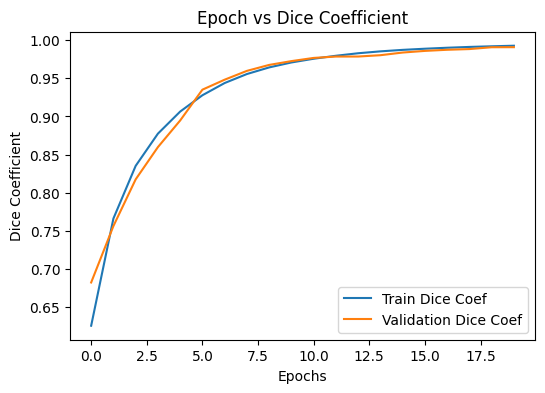

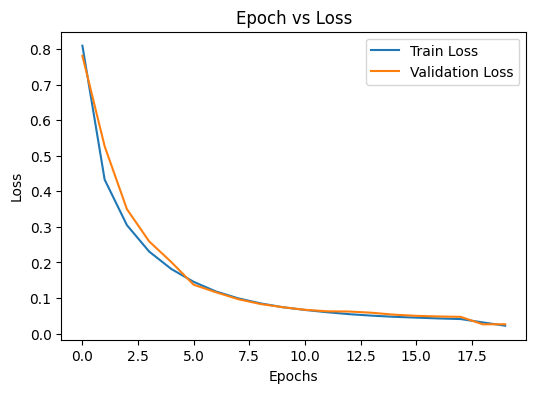

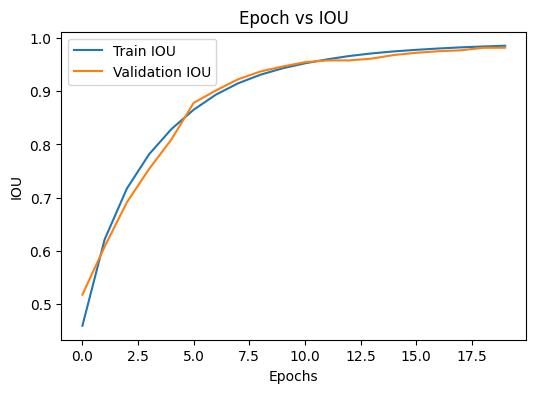

In [12]:
import matplotlib.pyplot as plt

# Extract metrics from history
epochs = range(len(Unetr_history.history['loss']))

# Plot epoch vs. Dice Coefficient
plt.figure(figsize=(6,4))
plt.plot(epochs, Unetr_history.history['final_output_dice_coef'], label='Train Dice Coef')
plt.plot(epochs, Unetr_history.history['val_final_output_dice_coef'], label='Validation Dice Coef')
plt.title('Epoch vs Dice Coefficient')
plt.xlabel('Epochs')
plt.ylabel('Dice Coefficient')
plt.legend()
plt.show()

# Plot epoch vs. Loss
plt.figure(figsize=(6,4))
plt.plot(epochs, Unetr_history.history['loss'], label='Train Loss')
plt.plot(epochs, Unetr_history.history['val_loss'], label='Validation Loss')
plt.title('Epoch vs Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Plot epoch vs. IOU
plt.figure(figsize=(6,4))
plt.plot(epochs, Unetr_history.history['final_output_iou'], label='Train IOU')
plt.plot(epochs, Unetr_history.history['val_final_output_iou'], label='Validation IOU')
plt.title('Epoch vs IOU')
plt.xlabel('Epochs')
plt.ylabel('IOU')
plt.legend()
plt.show()


In [16]:
from tqdm import tqdm
import os
import cv2
import numpy as np
from patchify import patchify
import tensorflow as tf

def create_dir(path):
    if not os.path.exists(path):
        os.makedirs(path)

# Configuration dictionary
cf = {}
cf["image_size"] = 256
cf["num_channels"] = 3
cf["num_layers"] = 12
cf["hidden_dim"] = 128
cf["mlp_dim"] = 32
cf["num_heads"] = 6
cf["dropout_rate"] = 0.1
cf["patch_size"] = 16
cf["num_patches"] = (cf["image_size"]**2)//(cf["patch_size"]**2)
cf["flat_patches_shape"] = (
    cf["num_patches"],
    cf["patch_size"]*cf["patch_size"]*cf["num_channels"]
)

if __name__ == "__main__":
    """ Seeding """
    np.random.seed(42)
    tf.random.set_seed(42)

    # Create the results directory if it doesn't exist
    create_dir("results_cup")

    """ Prediction """
    for x, y in tqdm(zip(test_x, test_y), total=len(test_x)):
        """ Extracting the name """
        name = x.split("/")[-1]

        """ Reading the image """
        image = cv2.imread(x, cv2.IMREAD_COLOR)
        image = cv2.resize(image, (cf["image_size"], cf["image_size"]))
        x_norm = image / 255.0  # Normalize the image

        # Patchify the image
        patch_shape = (cf["patch_size"], cf["patch_size"], cf["num_channels"])
        patches = patchify(x_norm, patch_shape, cf["patch_size"])
        patches = np.reshape(patches, cf["flat_patches_shape"])
        patches = patches.astype(np.float32)
        patches = np.expand_dims(patches, axis=0)

        """ Read Mask """
        mask = cv2.imread(y, cv2.IMREAD_GRAYSCALE)
        mask = cv2.resize(mask, (cf["image_size"], cf["image_size"]), interpolation=cv2.INTER_NEAREST)
        mask = ((mask == 128 )|(mask==255)).astype(np.float32)
        mask = np.stack([mask, mask, mask], axis=-1)  # Create a 3-channel mask for visualization

        """ Prediction """
        pred = model.predict(patches, verbose=0)[0]  # shape may be (256,256,1) or more
        pred = np.squeeze(pred)  # Remove extra dims -> (256,256)
        pred_rgb = np.stack([pred, pred, pred], axis=-1)  # (256,256,3) for visualization

        """ Save final visualization """
        line = np.ones((cf["image_size"], 10, 3), dtype=np.uint8) * 255  # White line
        cat_images = np.concatenate(
            [image, line, (mask * 255).astype(np.uint8), line, (pred_rgb * 255).astype(np.uint8)],
            axis=1
        )
        save_image_path = os.path.join("results_cup", name)
        cv2.imwrite(save_image_path, cat_images)

        """ Save predicted mask separately as grayscale """
        pred_mask_dir = "predicted_masks_gqa_cup"
        os.makedirs(pred_mask_dir, exist_ok=True)

        pred_mask = (pred * 255).astype(np.uint8)  # Grayscale mask
        pred_mask_path = os.path.join(pred_mask_dir, name)
        cv2.imwrite(pred_mask_path, pred_mask)


100%|██████████| 400/400 [00:36<00:00, 11.01it/s]


In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
import math

# ====== CONFIG ======
results_dir = "/kaggle/input/results/results"
thresholds = [0.3, 0.5, 0.7]  # Try multiple thresholds
cols = 3
rows_per_fig = 5  # number of rows per figure
t_show = 0.5      # threshold to display in plots
# ====================

# Collect saved composite images
saved_images = [img for img in os.listdir(results_dir) if img.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Dice and IoU functions
def dice_coef_np(y_true, y_pred, smooth=1e-6):
    y_true_f = y_true.flatten()
    y_pred_f = y_pred.flatten()
    intersection = np.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (np.sum(y_true_f) + np.sum(y_pred_f) + smooth)

def iou_np(y_true, y_pred, smooth=1e-6):
    y_true_f = y_true.flatten()
    y_pred_f = y_pred.flatten()
    intersection = np.sum(y_true_f * y_pred_f)
    union = np.sum(y_true_f) + np.sum(y_pred_f) - intersection
    return (intersection + smooth) / (union + smooth)

# For storing scores for each threshold
dice_scores_all = {t: [] for t in thresholds}
iou_scores_all = {t: [] for t in thresholds}

# Figure paging setup
images_per_fig = cols * rows_per_fig
num_figs = math.ceil(len(saved_images) / images_per_fig)

for fig_idx in range(num_figs):
    fig, axes = plt.subplots(rows_per_fig, cols, figsize=(15, 5 * rows_per_fig))
    axes = axes.flatten()

    start_idx = fig_idx * images_per_fig
    end_idx = min(start_idx + images_per_fig, len(saved_images))

    for ax_idx, img_idx in enumerate(range(start_idx, end_idx)):
        image_name = saved_images[img_idx]
        image_path = os.path.join(results_dir, image_name)
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        h, w, _ = image.shape
        section = (w - 20) // 3  # 2 lines of 10px between 3 sections

        original = image[:, :section]
        mask = image[:, section+10:2*section+10]
        pred = image[:, 2*section+20:]

        # Convert to grayscale & normalize
        mask_gray = cv2.cvtColor(mask, cv2.COLOR_RGB2GRAY) / 255.0
        pred_gray = cv2.cvtColor(pred, cv2.COLOR_RGB2GRAY) / 255.0

        # Loop over thresholds
        for t in thresholds:
            # Treat black (< threshold) as positive class
            mask_bin = (mask_gray < t).astype(np.float32)
            pred_bin = (pred_gray < t).astype(np.float32)

            dice = dice_coef_np(mask_bin, pred_bin)
            iou = iou_np(mask_bin, pred_bin)

            dice_scores_all[t].append(dice)
            iou_scores_all[t].append(iou)

        # Display image with metrics for t_show threshold
        dice_show = dice_scores_all[t_show][-1]
        iou_show = iou_scores_all[t_show][-1]
        axes[ax_idx].imshow(image)
        axes[ax_idx].set_title(f"{image_name}\nDice@{t_show}: {dice_show:.3f}, IoU@{t_show}: {iou_show:.3f}", fontsize=9)
        axes[ax_idx].axis('off')

    # Hide unused axes in last fig
    for empty_ax in axes[end_idx - start_idx:]:
        empty_ax.axis('off')

    plt.tight_layout()
    plt.show()

# Print average scores for each threshold
print("\n=== Average Scores by Threshold ===")
for t in thresholds:
    print(f"Threshold {t:.2f} -> Dice: {np.mean(dice_scores_all[t]):.4f}, IoU: {np.mean(iou_scores_all[t]):.4f}")

# Print overall averages across thresholds
all_dice = [score for t in thresholds for score in dice_scores_all[t]]
all_iou = [score for t in thresholds for score in iou_scores_all[t]]
print("\n=== Overall Averages Across Thresholds ===")
print(f"Average Dice: {np.mean(all_dice):.4f}")
print(f"Average IoU: {np.mean(all_iou):.4f}")



In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
import math

# ====== CONFIG ======
results_dir = "/kaggle/input/results/results"
thresholds = [0.3, 0.5, 0.7]  # Try multiple thresholds
cols = 3
rows_per_fig = 5  # number of rows per figure
# ====================

# Collect saved composite images
saved_images = [img for img in os.listdir(results_dir) if img.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Dice and IoU functions
def dice_coef_np(y_true, y_pred, smooth=1e-6):
    y_true_f = y_true.flatten()
    y_pred_f = y_pred.flatten()
    intersection = np.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (np.sum(y_true_f) + np.sum(y_pred_f) + smooth)

def iou_np(y_true, y_pred, smooth=1e-6):
    y_true_f = y_true.flatten()
    y_pred_f = y_pred.flatten()
    intersection = np.sum(y_true_f * y_pred_f)
    union = np.sum(y_true_f) + np.sum(y_pred_f) - intersection
    return (intersection + smooth) / (union + smooth)

# For storing best scores across images
best_dice_scores = []
best_iou_scores = []

# Calculate how many figures we need
images_per_fig = cols * rows_per_fig
num_figs = math.ceil(len(saved_images) / images_per_fig)

for fig_idx in range(num_figs):
    fig, axes = plt.subplots(rows_per_fig, cols, figsize=(15, 5 * rows_per_fig))
    axes = axes.flatten()

    start_idx = fig_idx * images_per_fig
    end_idx = min(start_idx + images_per_fig, len(saved_images))

    for ax_idx, img_idx in enumerate(range(start_idx, end_idx)):
        image_name = saved_images[img_idx]
        image_path = os.path.join(results_dir, image_name)
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        h, w, _ = image.shape
        section = (w - 20) // 3  # 2 lines of 10px between 3 sections

        original = image[:, :section]
        mask = image[:, section+10:2*section+10]
        pred = image[:, 2*section+20:]

        # Convert to grayscale & normalize
        mask_gray = cv2.cvtColor(mask, cv2.COLOR_RGB2GRAY) / 255.0
        pred_gray = cv2.cvtColor(pred, cv2.COLOR_RGB2GRAY) / 255.0

        # Track best per image
        best_dice = -1
        best_iou = -1
        best_thresh = None

        for t in thresholds:
            # Black (< threshold) = positive class
            mask_bin = (mask_gray < t).astype(np.float32)
            pred_bin = (pred_gray < t).astype(np.float32)

            dice = dice_coef_np(mask_bin, pred_bin)
            iou = iou_np(mask_bin, pred_bin)

            if dice > best_dice:  # update if better
                best_dice = dice
                best_iou = iou
                best_thresh = t

        best_dice_scores.append(best_dice)
        best_iou_scores.append(best_iou)

        axes[ax_idx].imshow(image)
        axes[ax_idx].set_title(f"{image_name}\nBest@{best_thresh:.2f} → Dice: {best_dice:.3f}, IoU: {best_iou:.3f}", fontsize=9)
        axes[ax_idx].axis('off')

    # Hide unused axes in last fig
    for empty_ax in axes[end_idx - start_idx:]:
        empty_ax.axis('off')

    plt.tight_layout()
    plt.show()

# Final averages of best scores
print("\n=== Best Scores per Image (Averaged) ===")
print(f"Average Best Dice: {np.mean(best_dice_scores):.4f}")
print(f"Average Best IoU: {np.mean(best_iou_scores):.4f}")


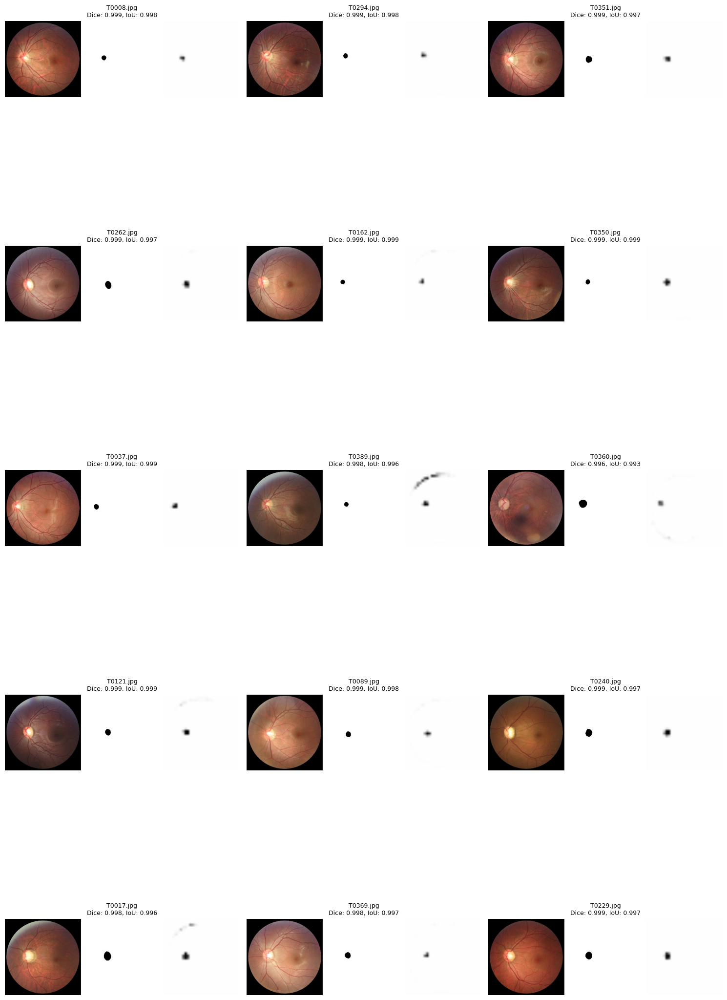

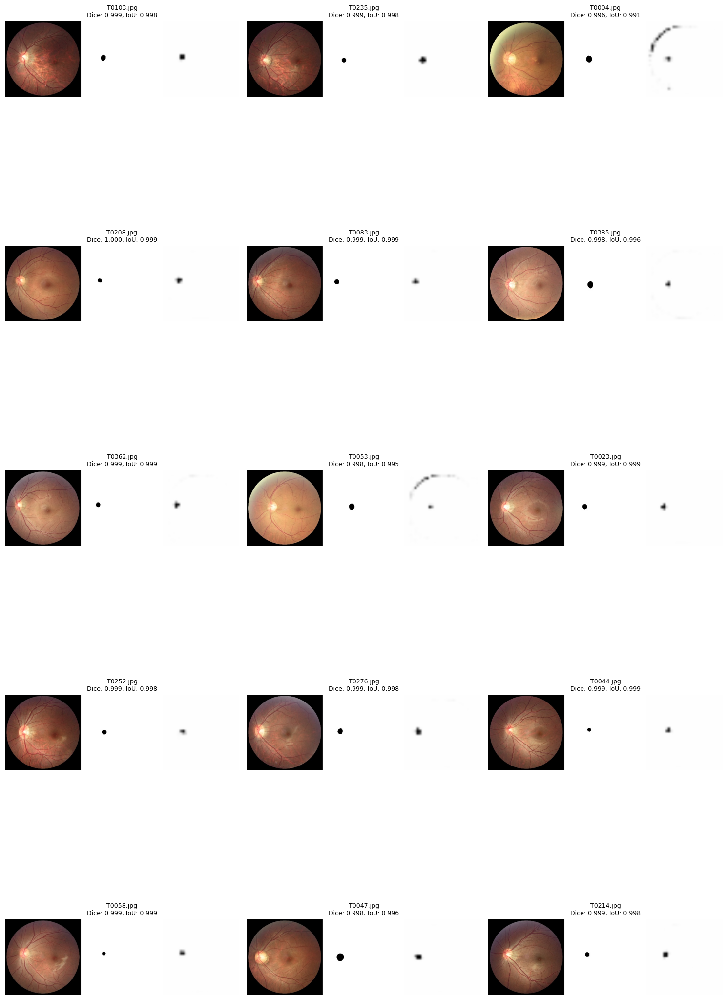

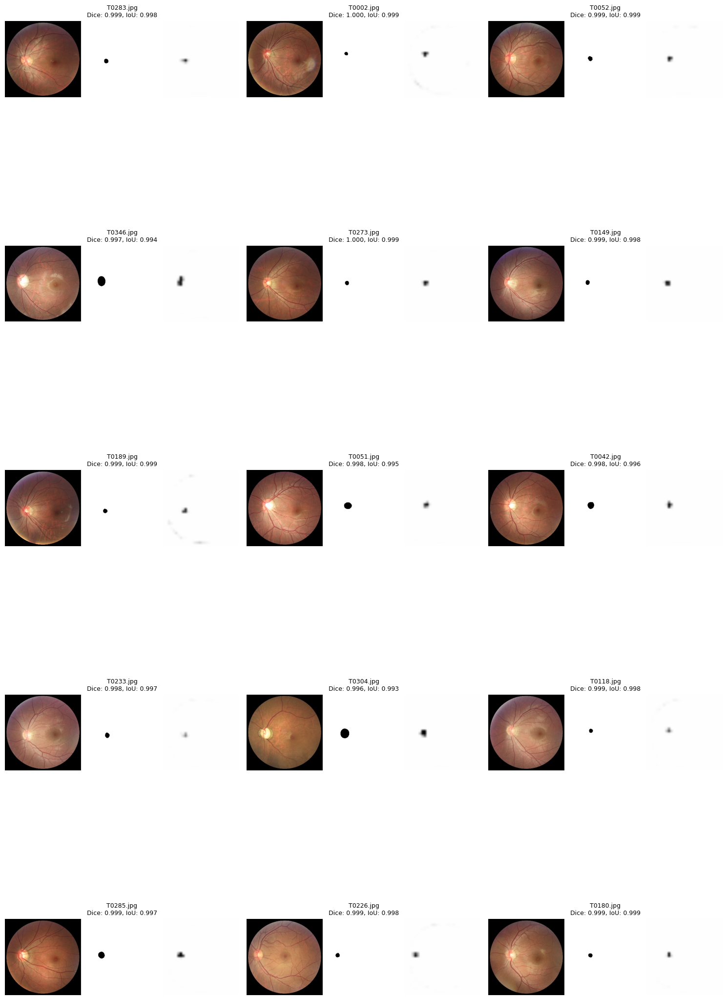

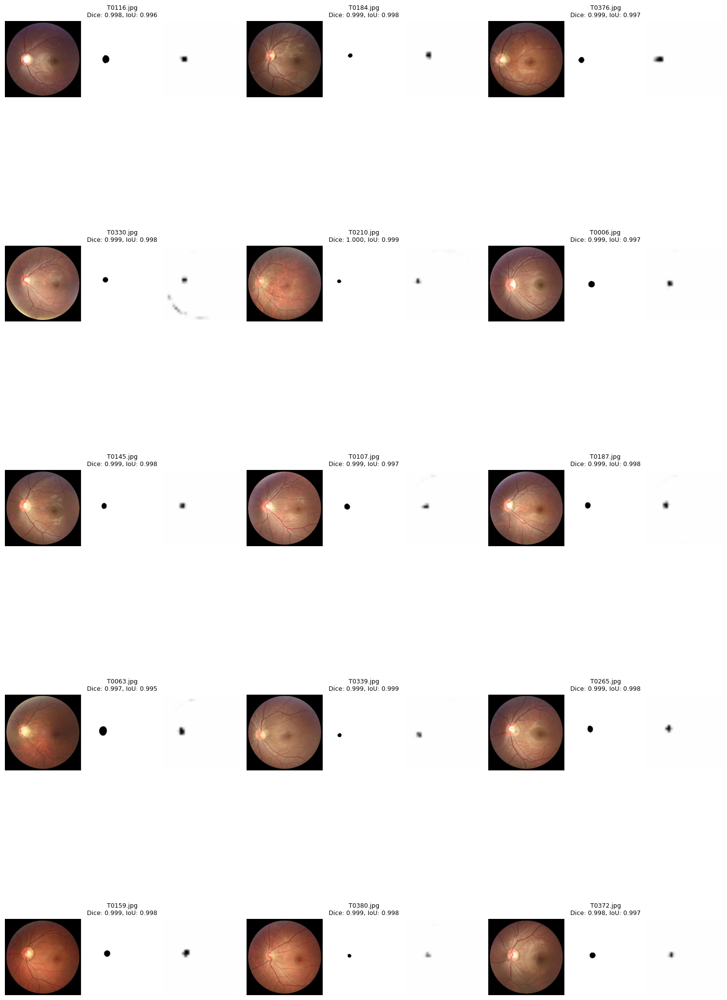

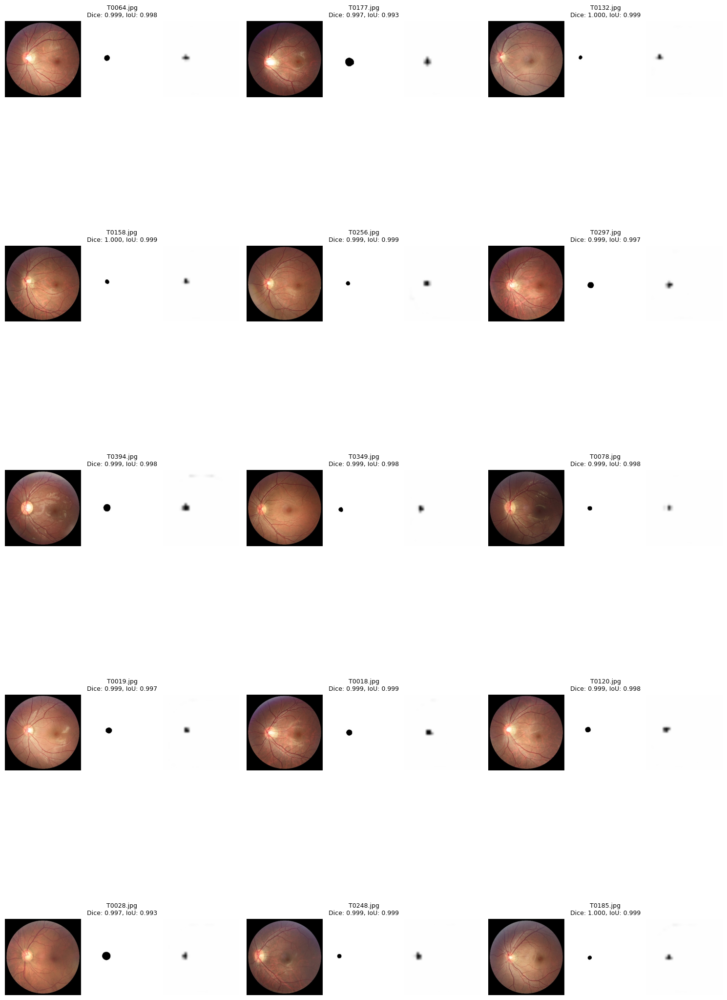

...

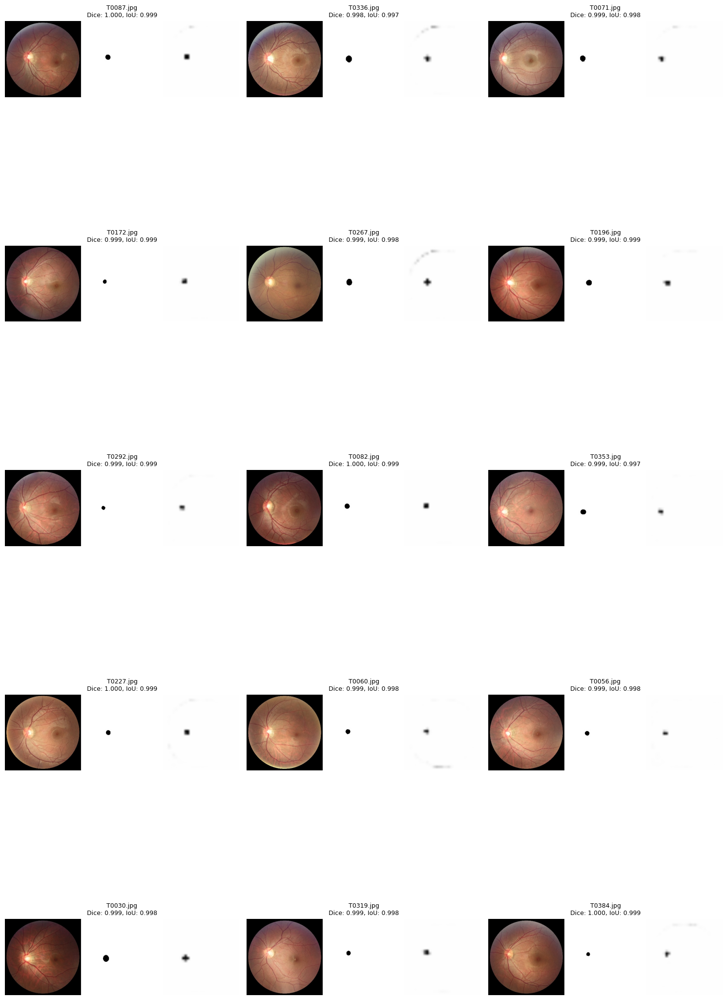

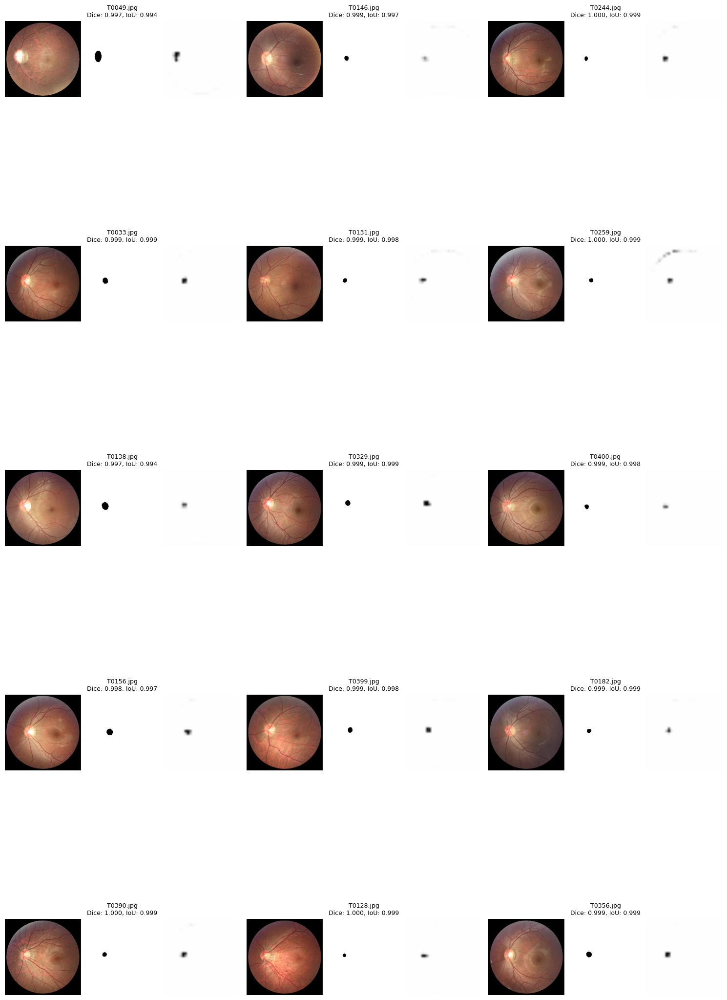

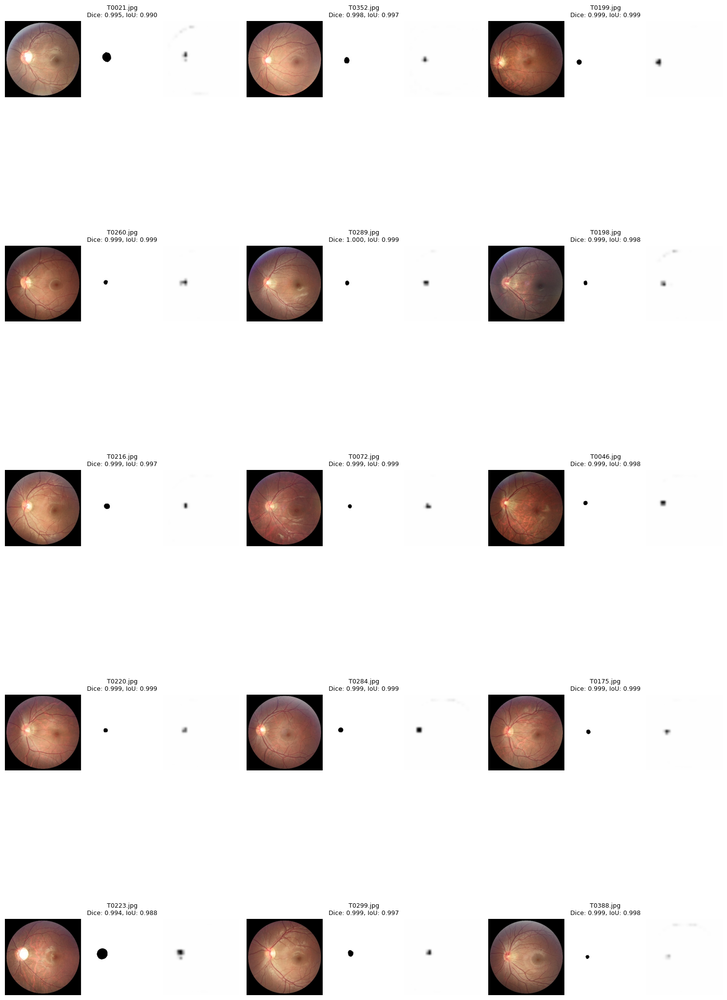

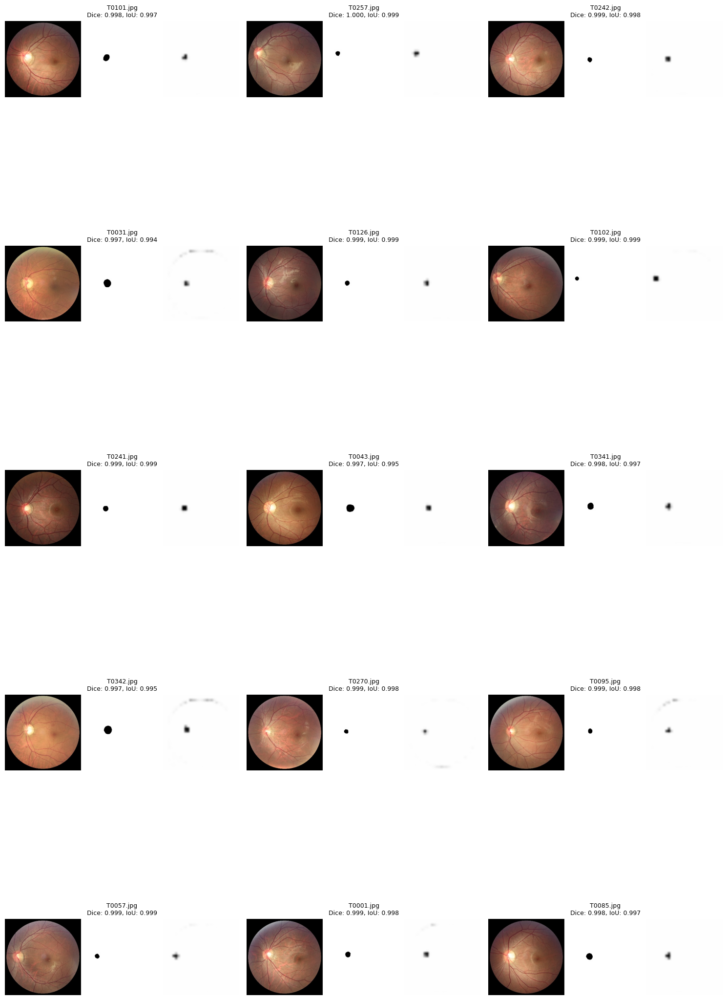

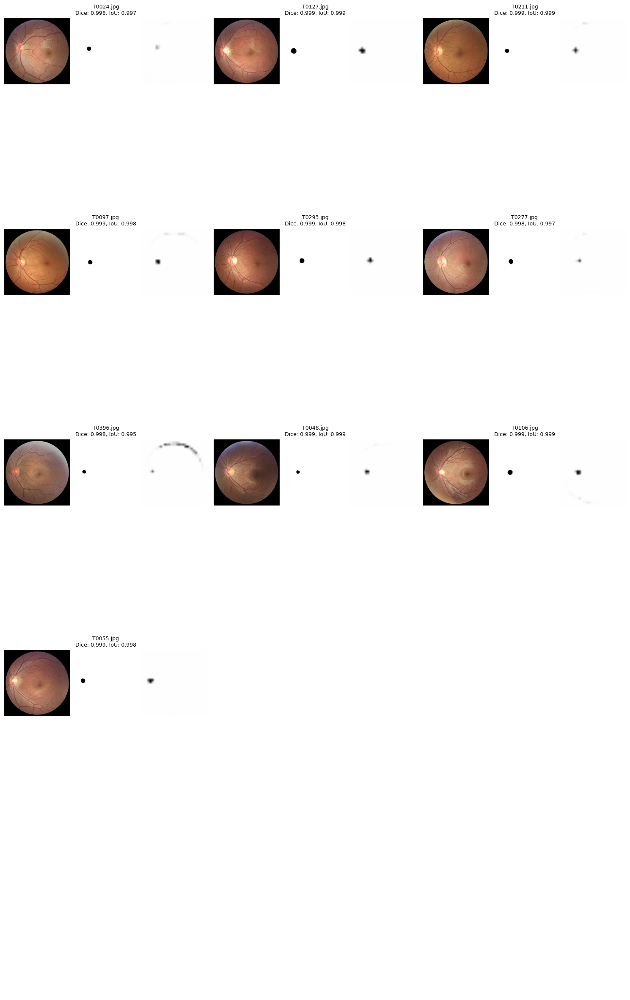


Average Dice Coefficient: 0.9988
Average IoU: 0.9976


In [18]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
import math

results_dir = "results_cup"
saved_images = os.listdir(results_dir)
saved_images = [img for img in saved_images if img.endswith(('.png', '.jpg', '.jpeg'))]

# Dice and IoU functions
def dice_coef_np(y_true, y_pred, smooth=1e-6):
    y_true_f = y_true.flatten()
    y_pred_f = y_pred.flatten()
    intersection = np.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (np.sum(y_true_f) + np.sum(y_pred_f) + smooth)

def iou_np(y_true, y_pred, smooth=1e-6):
    y_true_f = y_true.flatten()
    y_pred_f = y_pred.flatten()
    intersection = np.sum(y_true_f * y_pred_f)
    union = np.sum(y_true_f) + np.sum(y_pred_f) - intersection
    return (intersection + smooth) / (union + smooth)

# Config for chunked plotting
cols = 3
rows_per_fig = 5  # Max rows per figure
images_per_fig = cols * rows_per_fig
num_figs = math.ceil(len(saved_images) / images_per_fig)

dice_scores = []
iou_scores = []

for fig_idx in range(num_figs):
    fig, axes = plt.subplots(rows_per_fig, cols, figsize=(15, 5 * rows_per_fig))
    axes = axes.flatten()

    start_idx = fig_idx * images_per_fig
    end_idx = min(start_idx + images_per_fig, len(saved_images))

    for ax_idx, img_idx in enumerate(range(start_idx, end_idx)):
        image_name = saved_images[img_idx]
        image_path = os.path.join(results_dir, image_name)
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        h, w, _ = image.shape
        section = (w - 20) // 3  # 2 lines of 10 px between 3 images

        original = image[:, :section]
        mask = image[:, section+10:2*section+10]
        pred = image[:, 2*section+20:]

        # Convert to grayscale and normalize
        mask_gray = cv2.cvtColor(mask, cv2.COLOR_RGB2GRAY) / 255.0
        pred_gray = cv2.cvtColor(pred, cv2.COLOR_RGB2GRAY) / 255.0

        # Black = positive
        mask_bin = (mask_gray > 0.5).astype(np.float32)
        pred_bin = (pred_gray > 0.5).astype(np.float32)

        dice = dice_coef_np(mask_bin, pred_bin)
        iou = iou_np(mask_bin, pred_bin)

        dice_scores.append(dice)
        iou_scores.append(iou)

        axes[ax_idx].imshow(image)
        axes[ax_idx].set_title(f"{image_name}\nDice: {dice:.3f}, IoU: {iou:.3f}", fontsize=9)
        axes[ax_idx].axis('off')

    # Hide any unused subplots
    for empty_ax in axes[end_idx - start_idx:]:
        empty_ax.axis('off')

    plt.tight_layout()
    plt.show()

print(f"\nAverage Dice Coefficient: {np.mean(dice_scores):.4f}")
print(f"Average IoU: {np.mean(iou_scores):.4f}")
